W0000 00:00:1727234799.211579   13494 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1727234799.227100   13507 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
/workspace/.pyenv_mirror/user/current/lib/python3.12/site-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


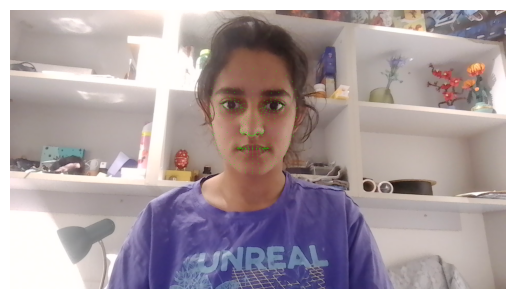

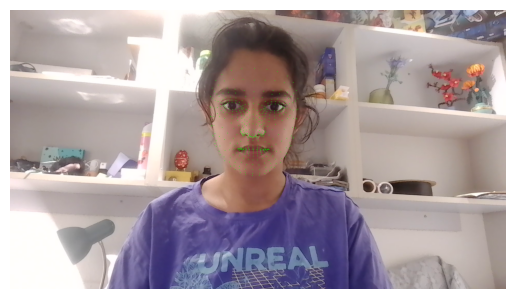

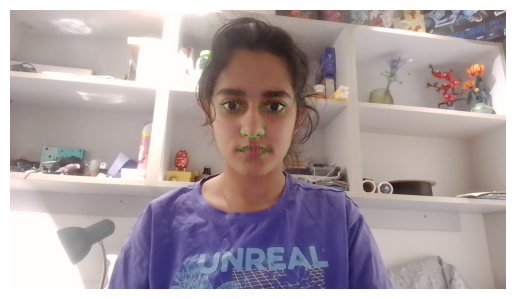

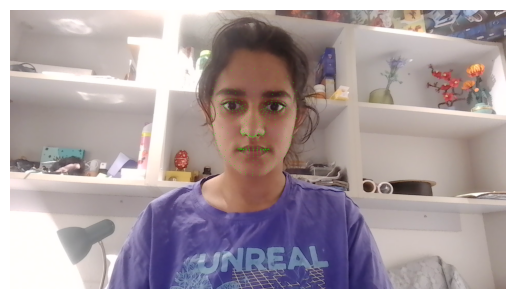

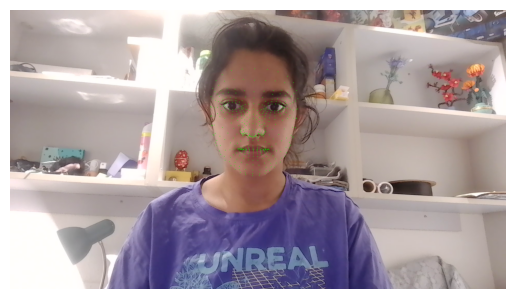

...

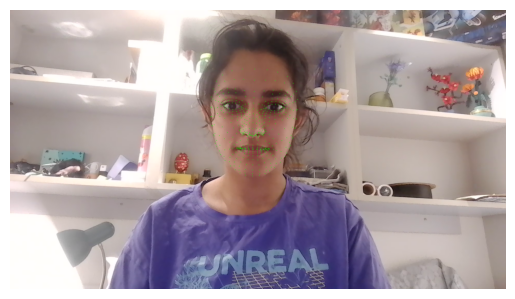

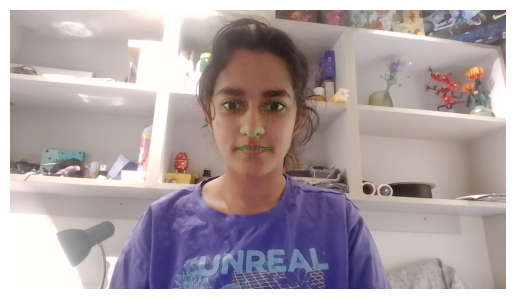

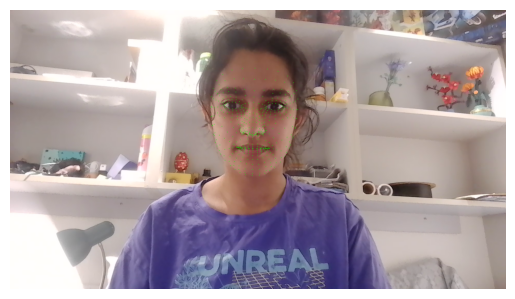

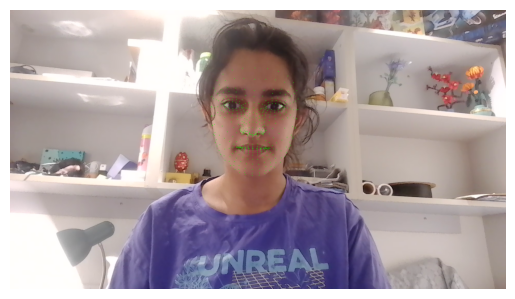

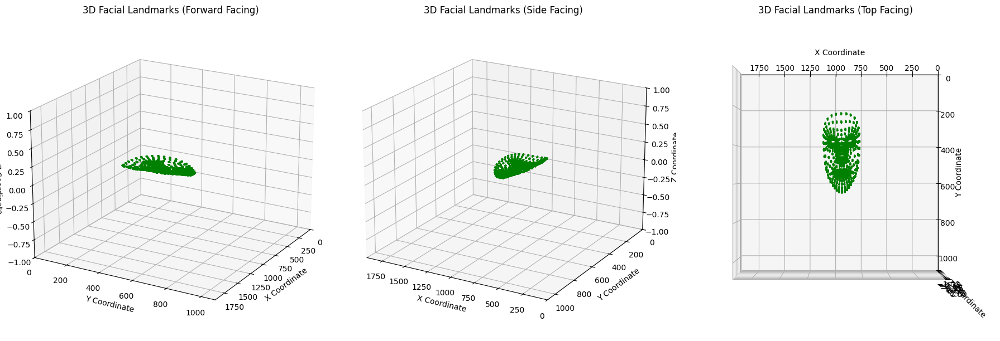

In [11]:
import cv2
import mediapipe as mp
import os
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from sklearn.neighbors import NearestNeighbors

os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
mp_face_mesh = mp.solutions.face_mesh
face_mesh = mp_face_mesh.FaceMesh(static_image_mode=False, max_num_faces=1)

cap = cv2.VideoCapture('output.mp4')

plt.ion()
frame_count = 0
max_frames = 100
all_points = []

while cap.isOpened() and frame_count < max_frames:
    ret, frame = cap.read()
    if not ret:
        break

    rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    result = face_mesh.process(rgb_frame)

    if result.multi_face_landmarks:
        for face_landmarks in result.multi_face_landmarks:
            points_3d = []
            for landmark in face_landmarks.landmark:
                x = landmark.x * frame.shape[1]
                y = landmark.y * frame.shape[0]
                z = landmark.z
                points_3d.append([x, y, z])

            all_points.extend(points_3d)
            for landmark in face_landmarks.landmark:
                x = int(landmark.x * frame.shape[1])
                y = int(landmark.y * frame.shape[0])
                cv2.circle(frame, (x, y), 1, (0, 255, 0), -1)

    plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()
    plt.pause(0.001)
    frame_count += 1

cap.release()
plt.ioff()

points = np.array(all_points)
nbrs = NearestNeighbors(n_neighbors=10)
nbrs.fit(points)
distances, indices = nbrs.kneighbors(points)

colors = []
threshold_density = 5

for distance in distances:
    if np.sum(distance < 0.05) > threshold_density:
        colors.append('blue')
    else:
        colors.append('green')

fig = plt.figure(figsize=(18, 6))

ax1 = fig.add_subplot(131, projection='3d')
ax1.scatter(points[:, 0], points[:, 1], points[:, 2], c=colors, marker='o', s=1)
ax1.set_xlabel('X Coordinate')
ax1.set_ylabel('Y Coordinate')
ax1.set_zlabel('Z Coordinate')
ax1.set_title('3D Facial Landmarks (Forward Facing)')
ax1.view_init(elev=20, azim=30)
ax1.set_xlim([0, frame.shape[1]])
ax1.set_ylim([0, frame.shape[0]])
ax1.set_zlim([-1, 1])

ax2 = fig.add_subplot(132, projection='3d')
ax2.scatter(points[:, 0], points[:, 1], points[:, 2], c=colors, marker='o', s=1)
ax2.set_xlabel('X Coordinate')
ax2.set_ylabel('Y Coordinate')
ax2.set_zlabel('Z Coordinate')
ax2.set_title('3D Facial Landmarks (Side Facing)')
ax2.view_init(elev=20, azim=120)
ax2.set_xlim([0, frame.shape[1]])
ax2.set_ylim([0, frame.shape[0]])
ax2.set_zlim([-1, 1])

ax3 = fig.add_subplot(133, projection='3d')
ax3.scatter(points[:, 0], points[:, 1], points[:, 2], c=colors, marker='o', s=1)
ax3.set_xlabel('X Coordinate')
ax3.set_ylabel('Y Coordinate')
ax3.set_zlabel('Z Coordinate')
ax3.set_title('3D Facial Landmarks (Top Facing)')
ax3.view_init(elev=90, azim=90)
ax3.set_xlim([0, frame.shape[1]])
ax3.set_ylim([0, frame.shape[0]])
ax3.set_zlim([-1, 1])

plt.tight_layout()
plt.show()
